Experimental Dataset - 2D class - class 39 - 128x128

# Setup

In [1]:
%matplotlib inline
import os, sys, glob, shutil
from matplotlib import pyplot as plt
import numpy as np
import torch
import h5py
from sklearn import metrics
sys.path.append('../utils/')
import functions_for_fred as fn
import nn
import viz
import pred

In [2]:
print('we are here {}'.format(os.getcwd()))

we are here /gpfs/slac/cryo/fs1/g/ML/vaegan/analysis


In [3]:
KEYWORD      = 'cryo_exp_class_2d_39_128x128'
CHECKPT_FILE = 'cryo_exp_class_2d_39_epoch_255_checkpoint.pth'
EPOCH_NUMBER = 255

In [4]:
DATASET_DIR     = '../train_val_datasets/'
METADATASET_DIR = '../datasets/exp/20181005-rib-TEM4/Sort/'
TRAINED_DIR = '../train_vae/'
TRAIN_DATASET_PATH     = DATASET_DIR+KEYWORD+'.npy'
TRAIN_METADATASET_PATH = METADATASET_DIR+'class2D_39_sort.h5'
TRAINED_CHECKPOINT     = 'epoch_'+str(EPOCH_NUMBER)+'_checkpoint.pth'
if not os.path.exists(KEYWORD):
    os.makedirs(KEYWORD)
if not os.path.exists(KEYWORD+'/train_vae'):
    os.makedirs(KEYWORD+'/train_vae')
if not os.path.isfile(KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT):
    shutil.copyfile(TRAINED_DIR+CHECKPT_FILE, KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT)

# Load dataset, encoder and decoder

In [5]:
dataset = np.load(TRAIN_DATASET_PATH)
metadata = h5py.File(TRAIN_METADATASET_PATH, 'r')
print('dataset.shape {} metadata.shape {}'.format(dataset.shape, metadata['particles'].shape))

dataset.shape (5119, 1, 128, 128) metadata.shape (5119, 180, 180)


In [6]:
mus = []
mus = fn.latent_projection(KEYWORD, TRAIN_DATASET_PATH, epoch_id=EPOCH_NUMBER)
mus.shape

cryo_exp_class_2d_39_128x128/train_vae/epoch_255_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_39_128x128/train_vae/epoch_255_checkpoint.pth.
Loading encoder from network of architecture: conv_orig...


(5119, 4)

In [7]:
recon = []
recon = fn.reconstruction(KEYWORD, torch.Tensor(mus[0:500,...]).cuda(), epoch_id=EPOCH_NUMBER)
recon.shape

cryo_exp_class_2d_39_128x128/train_vae/epoch_255_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_39_128x128/train_vae/epoch_255_checkpoint.pth.
Loading decoder from network of architecture: conv_orig...


(500, 1, 128, 128)

In [8]:
list(metadata.keys())

['_rlnamplitudecontrast',
 '_rlnanglepsi',
 '_rlnanglerot',
 '_rlnangletilt',
 '_rlnautopickfigureofmerit',
 '_rlnclassnumber',
 '_rlncoordinatex',
 '_rlncoordinatey',
 '_rlnctfbfactor',
 '_rlnctffigureofmerit',
 '_rlnctfmaxresolution',
 '_rlnctfscalefactor',
 '_rlndefocusangle',
 '_rlndefocusu',
 '_rlndefocusv',
 '_rlndetectorpixelsize',
 '_rlngroupnumber',
 '_rlnimagename',
 '_rlnloglikelicontribution',
 '_rlnmagnification',
 '_rlnmaxvalueprobdistribution',
 '_rlnmicrographname',
 '_rlnnormcorrection',
 '_rlnnrofsignificantsamples',
 '_rlnoriginx',
 '_rlnoriginy',
 '_rlnparticleselectzscore',
 '_rlnphaseshift',
 '_rlnsphericalaberration',
 '_rlnvoltage',
 'particles']

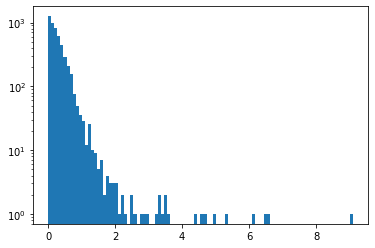

0.29390269770115257 0.38519839204161177


In [9]:
Zscore = np.array(metadata['_rlnparticleselectzscore'])
plt.hist(Zscore, bins=100, log=True)
plt.show()
print(np.mean(Zscore), np.std(Zscore))

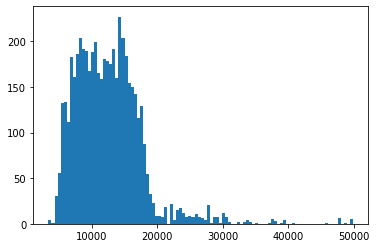

3333.739502 12408.233953110177 5213.635159191951


In [10]:
defocus = np.array(metadata['_rlndefocusu'])
plt.hist(defocus, bins=100, log=False)
plt.show()
print(np.min(defocus),np.mean(defocus), np.std(defocus))

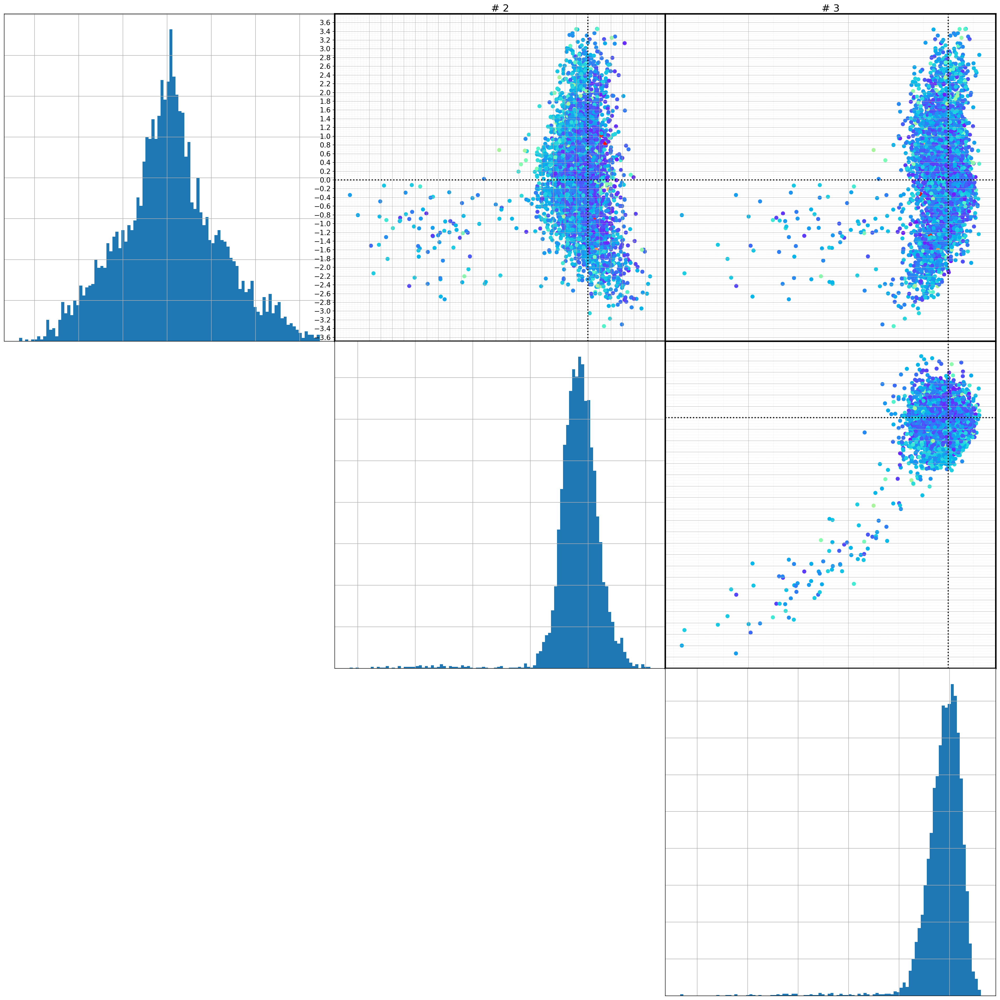

In [11]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_defocus_true')

In [11]:
center = np.mean(mus,axis=0) #np.zeros(mus.shape) #
U, L, Vt = np.linalg.svd(mus - center, full_matrices=False)

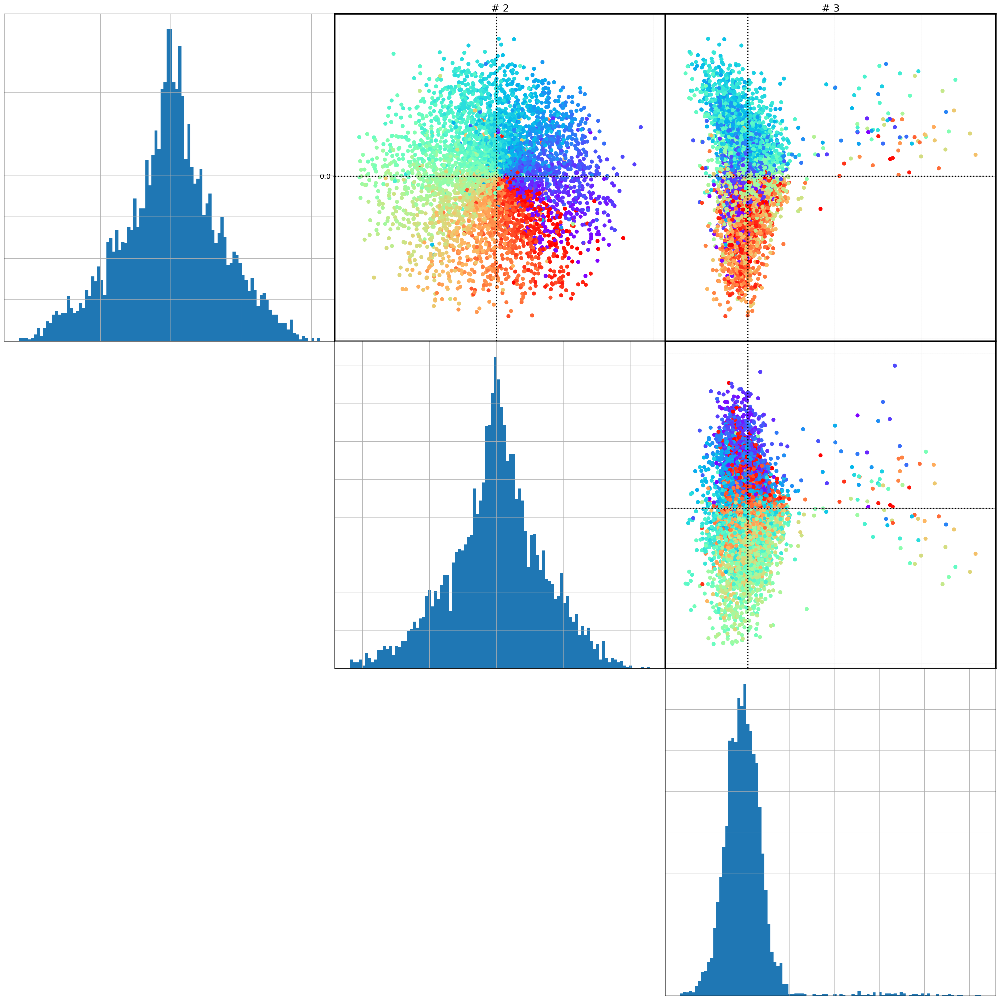

In [13]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=metadata['_rlnanglepsi'], 
            figname=KEYWORD+'/latent_space_pca_defocus_true')

In [12]:
Zscore_set=2

In [13]:
positives = np.where(Zscore<Zscore_set)[0]
negatives = np.where(Zscore>Zscore_set)[0]
print(positives.shape,negatives.shape)

(5090,) (29,)


AUC(robust_covar) = 0.8631122552672582
AUC(isolation_forest) = 0.8569405866811192
AUC(local_outlier_detection) = 0.6733825621570354


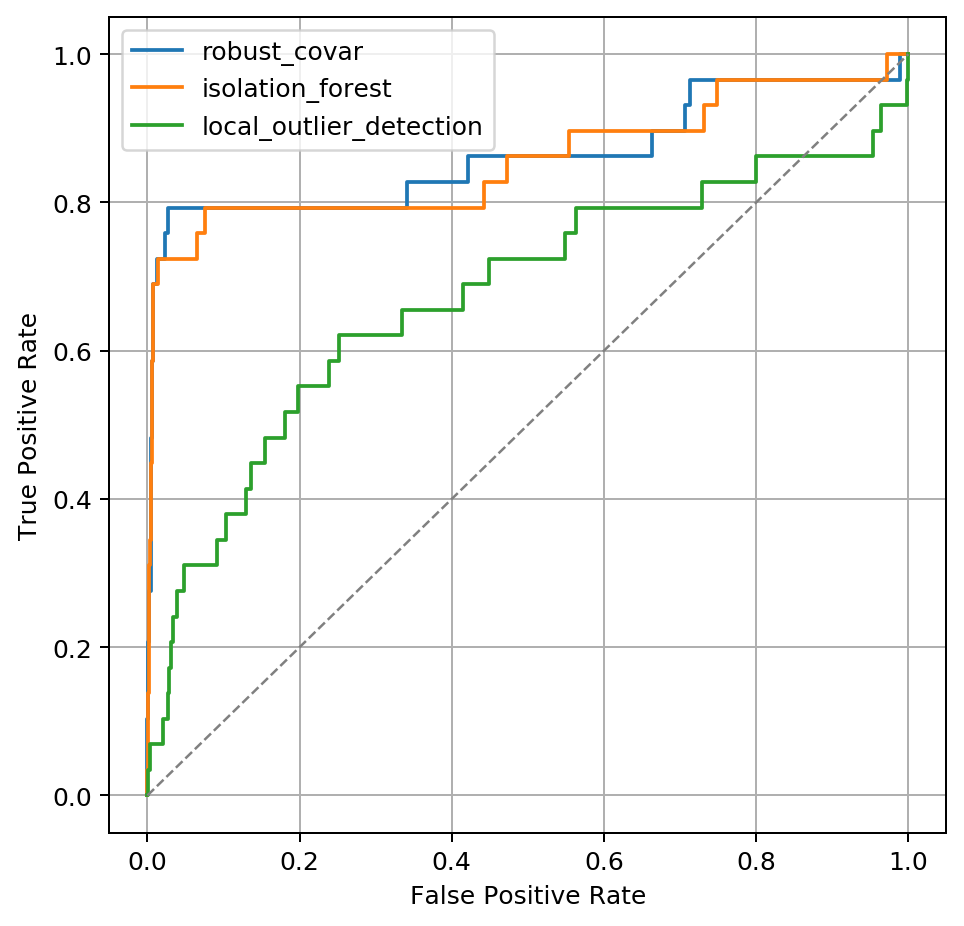

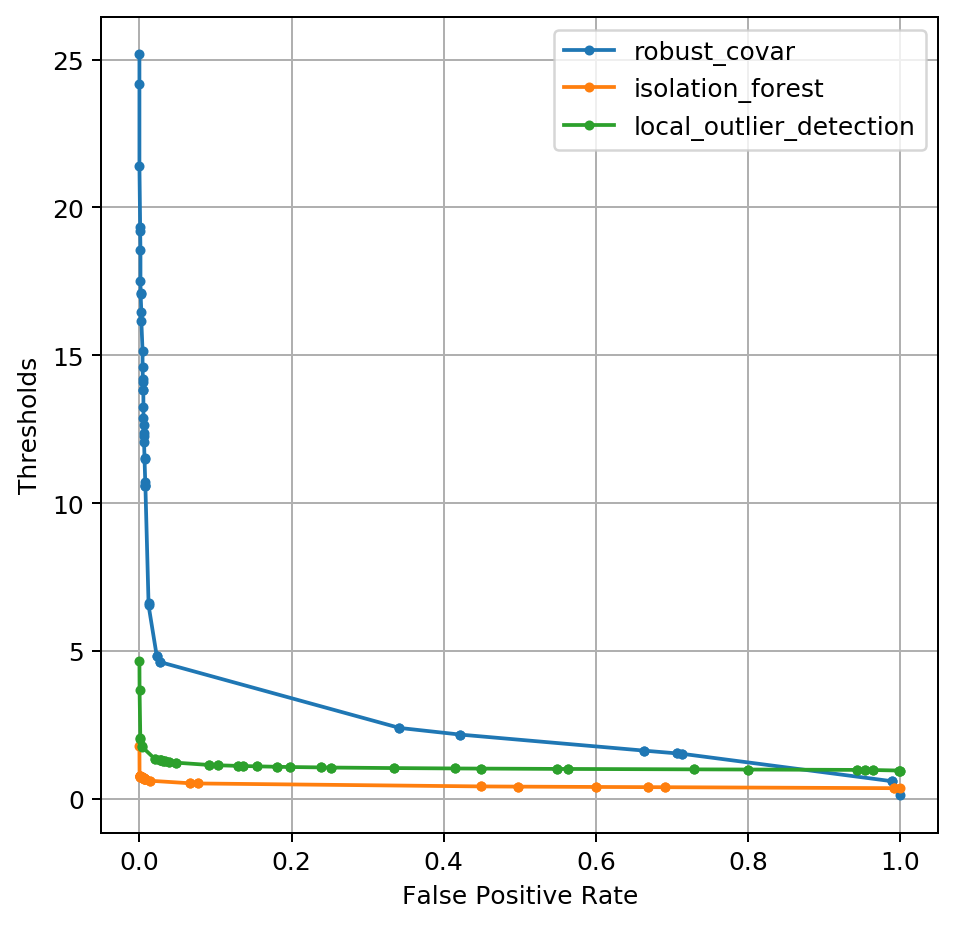

In [14]:
methods = ['robust_covar', 'isolation_forest', 'local_outlier_detection']
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,tpr)
    print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_Zscore'+str(Zscore_set))
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('Thresholds')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,thresholds, '.-')
    #print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
#plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_thresholds'+str(Zscore_set))

In [15]:
measure, offset, assignment = pred.outlier_measure(mus, method='robust_covar')

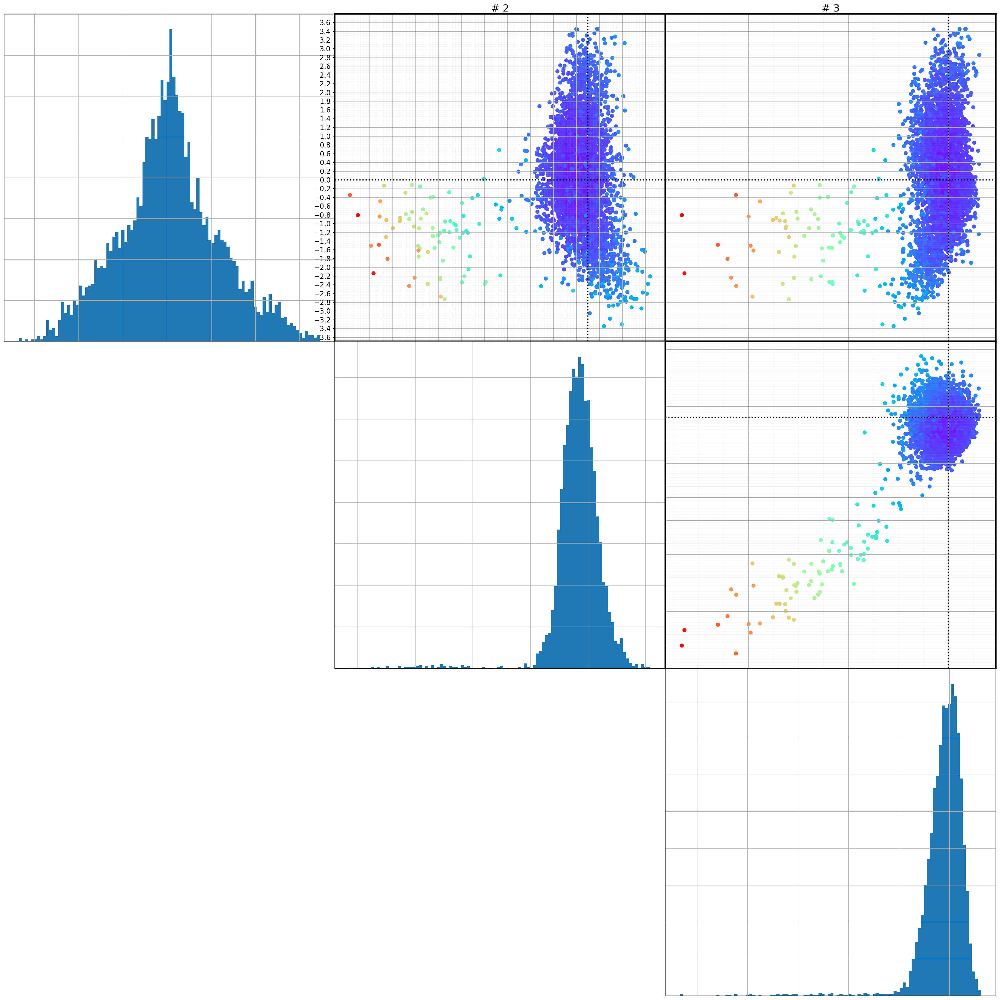

In [18]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=measure, figname=KEYWORD+'/latent_space_robust_covar')

In [16]:
measure_threshold=5

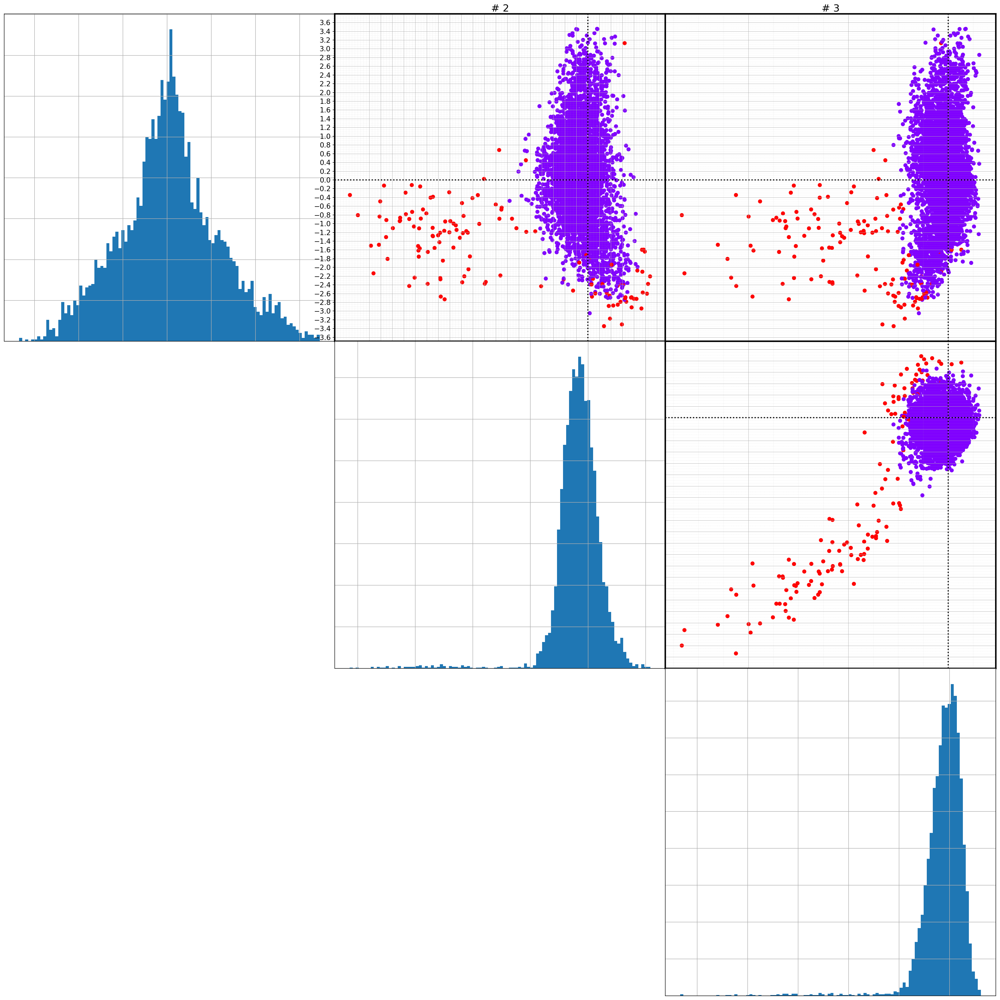

In [20]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=np.where(measure<measure_threshold,0,1), figname=KEYWORD+'/latent_space_robust_covar_assigned')

In [17]:
mus_kept = mus[np.where(measure<measure_threshold),:][0,...]
print(mus_kept.shape)
defocus_kept = np.array(metadata['_rlndefocusu'])[np.where(measure<measure_threshold)]
print(defocus_kept.shape)
angle_kept = np.array(metadata['_rlnanglepsi'])[np.where(measure<measure_threshold)]
print(angle_kept.shape)
Zscore_kept = np.array(metadata['_rlnparticleselectzscore'])[np.where(measure<measure_threshold)]
print(Zscore_kept.shape)

(4990, 4)
(4990,)
(4990,)
(4990,)


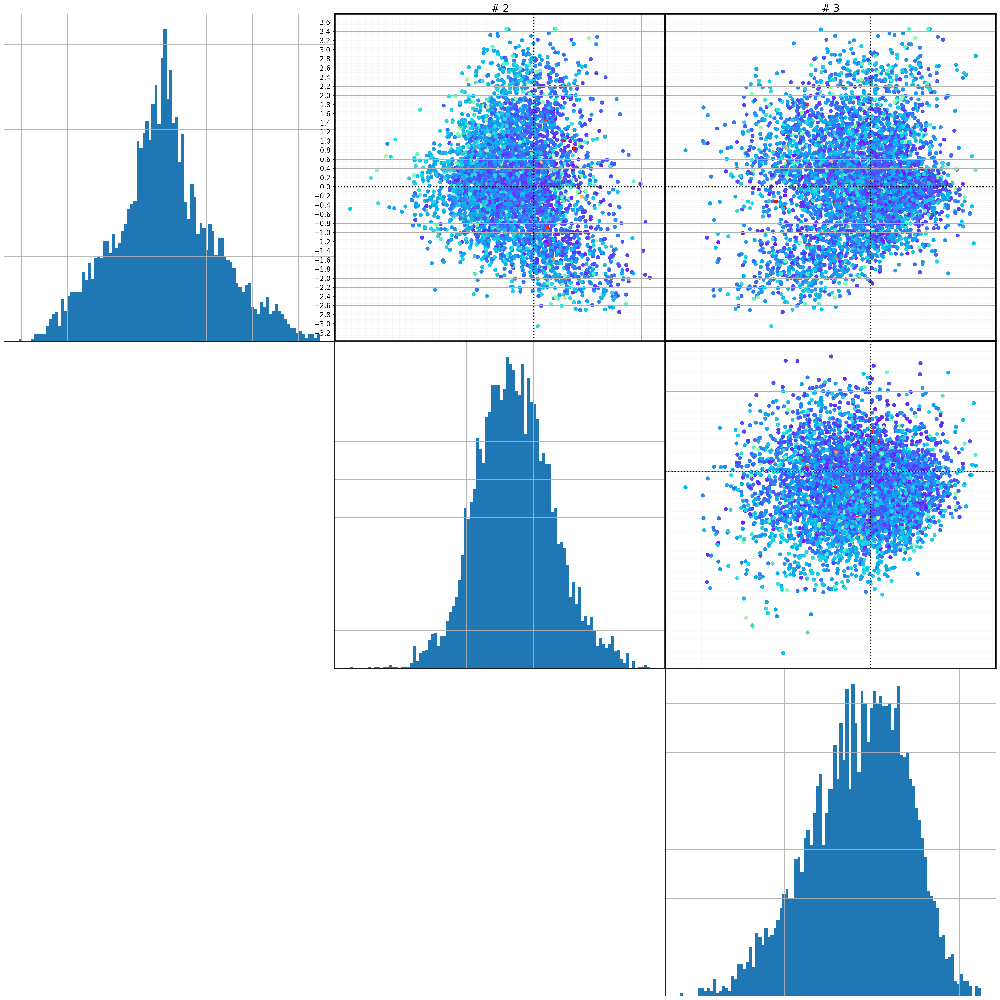

In [22]:
viz.biplots(mus_kept, n=3, show_histo=True, nbins=100, c=defocus_kept)

In [18]:
center = np.mean(mus_kept,axis=0) #np.zeros(mus_kept.shape) #
U, L, Vt = np.linalg.svd(mus_kept - center, full_matrices=False)

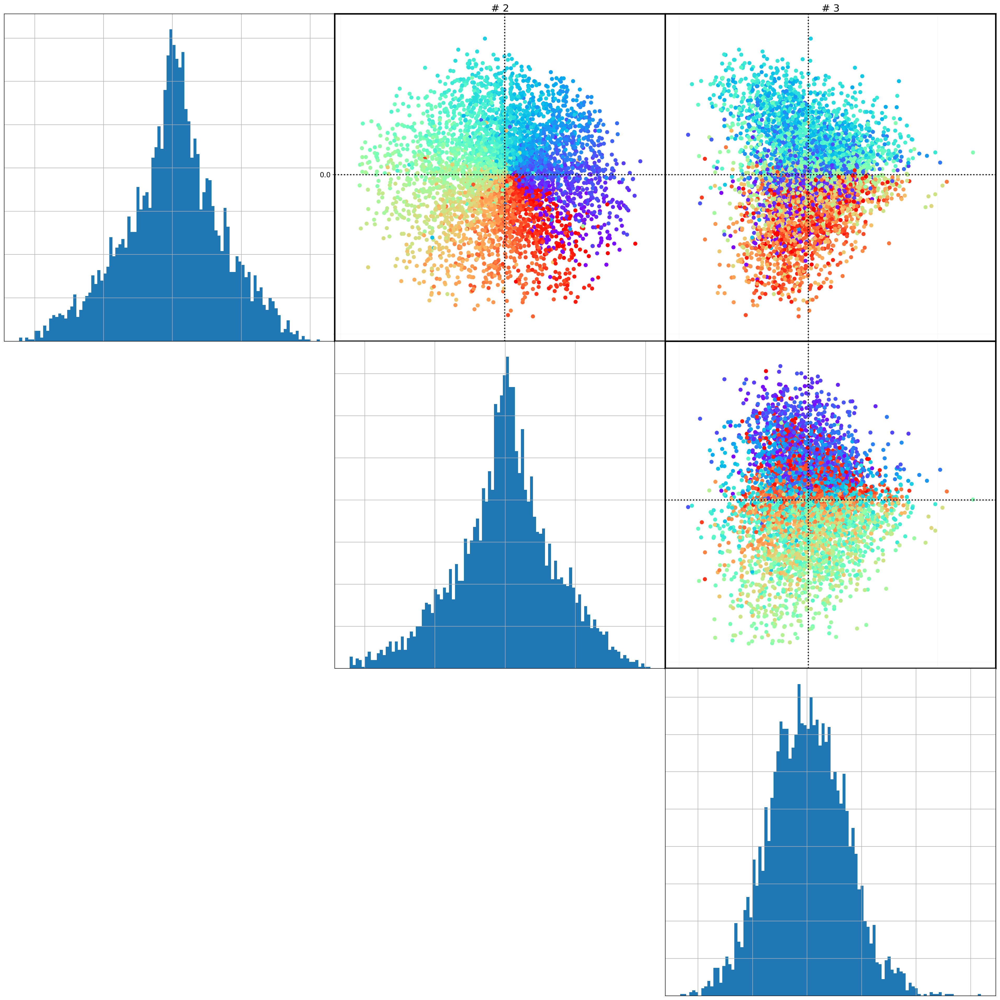

In [24]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=angle_kept)

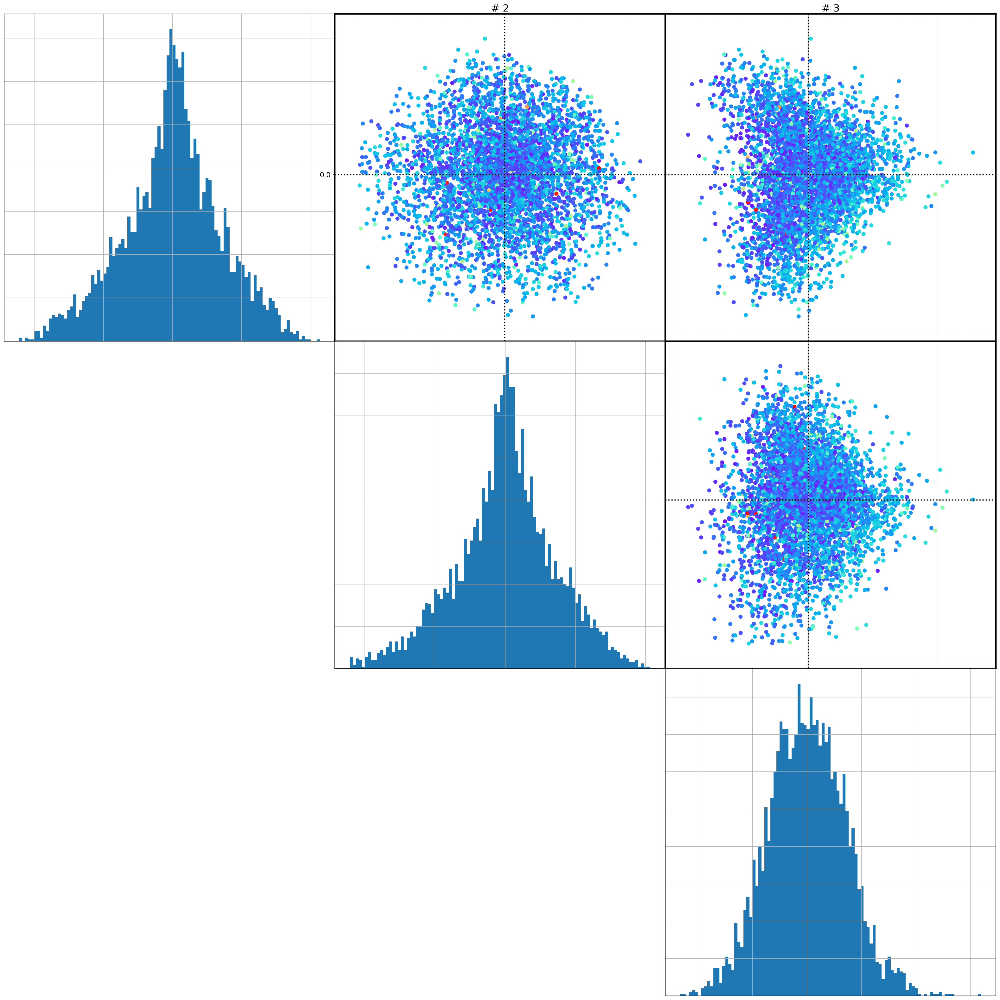

In [25]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=defocus_kept)

In [19]:
angle_true   = angle_kept + 180
defocus_true = defocus_kept

In [20]:
index = np.where((defocus_kept>5000)  & (defocus_kept < 25000))[0]

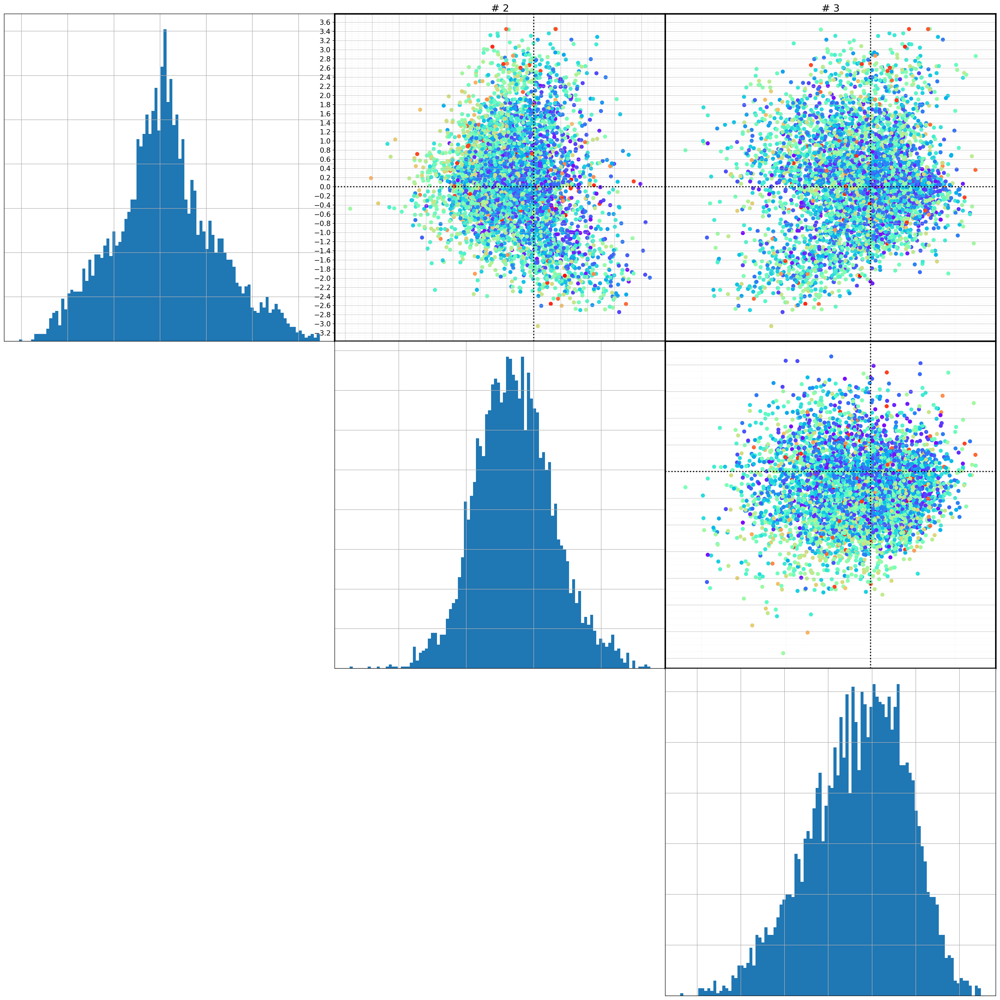

In [28]:
viz.biplots(mus_kept[index,:], n=3, show_histo=True, nbins=100, c=defocus_kept[index])

In [21]:
center = np.mean(mus_kept[index,:],axis=0) #np.zeros(mus_kept[index,:].shape) #
U_restricted, L_restricted, Vt_restricted = np.linalg.svd(mus_kept[index,:] - center, full_matrices=False)

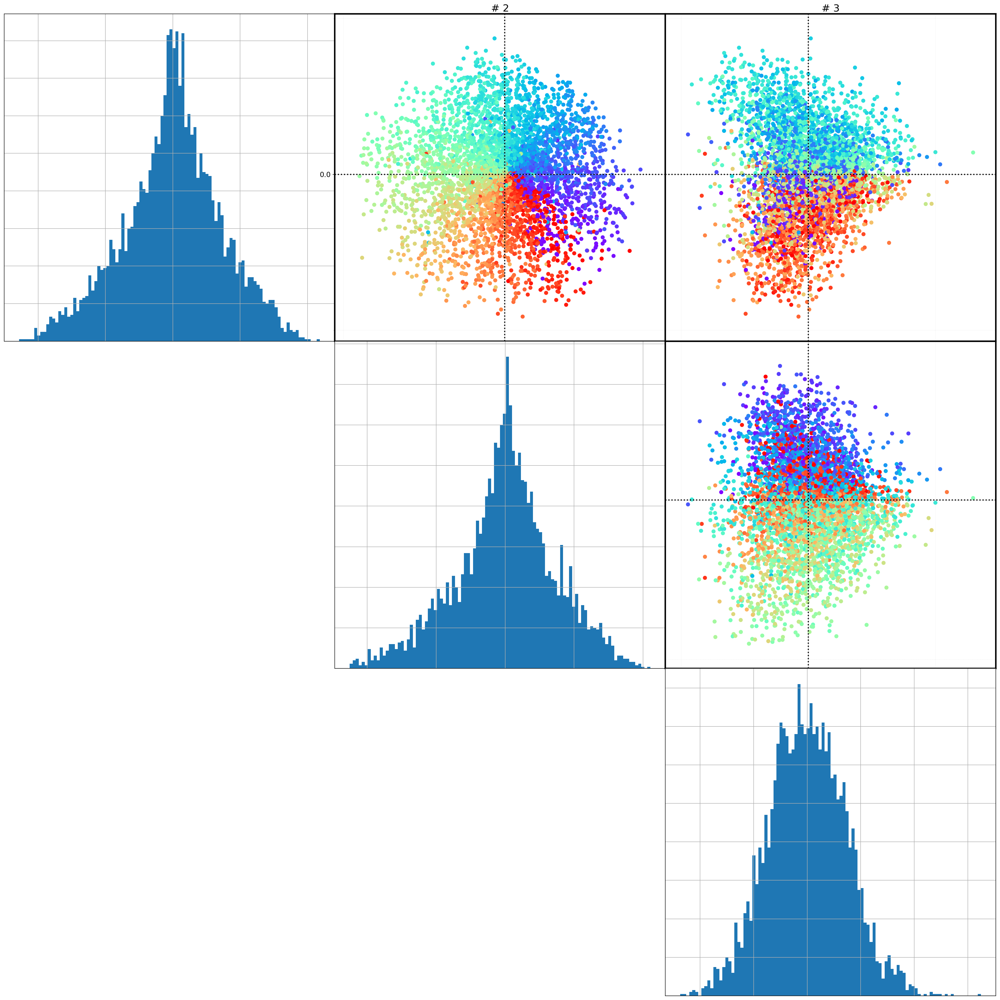

In [30]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=angle_kept[index])

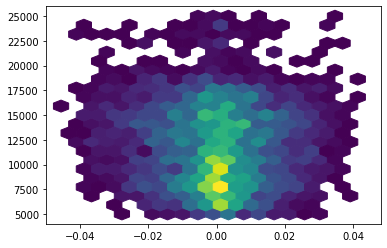

In [32]:
plt.hexbin(U_restricted[:,0],defocus_kept[index], mincnt=1, gridsize=20)

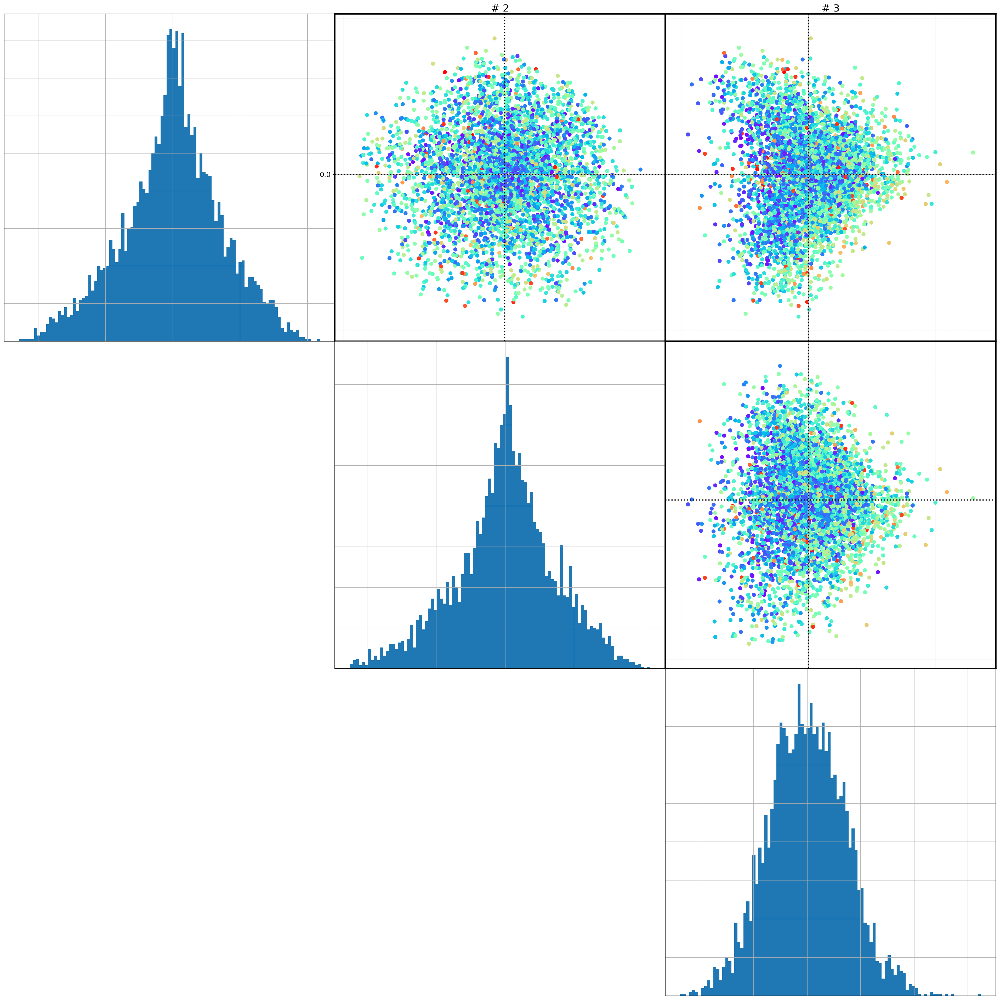

In [31]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=defocus_kept[index])

In [22]:
angle_restricted = angle_kept[index]
defocus_restricted = defocus_kept[index]

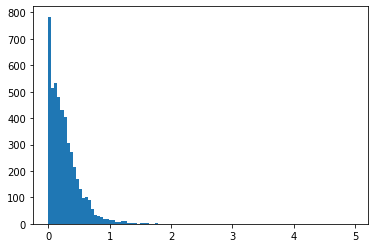

In [22]:
plt.hist(Zscore_kept[index], bins=100)
plt.show()

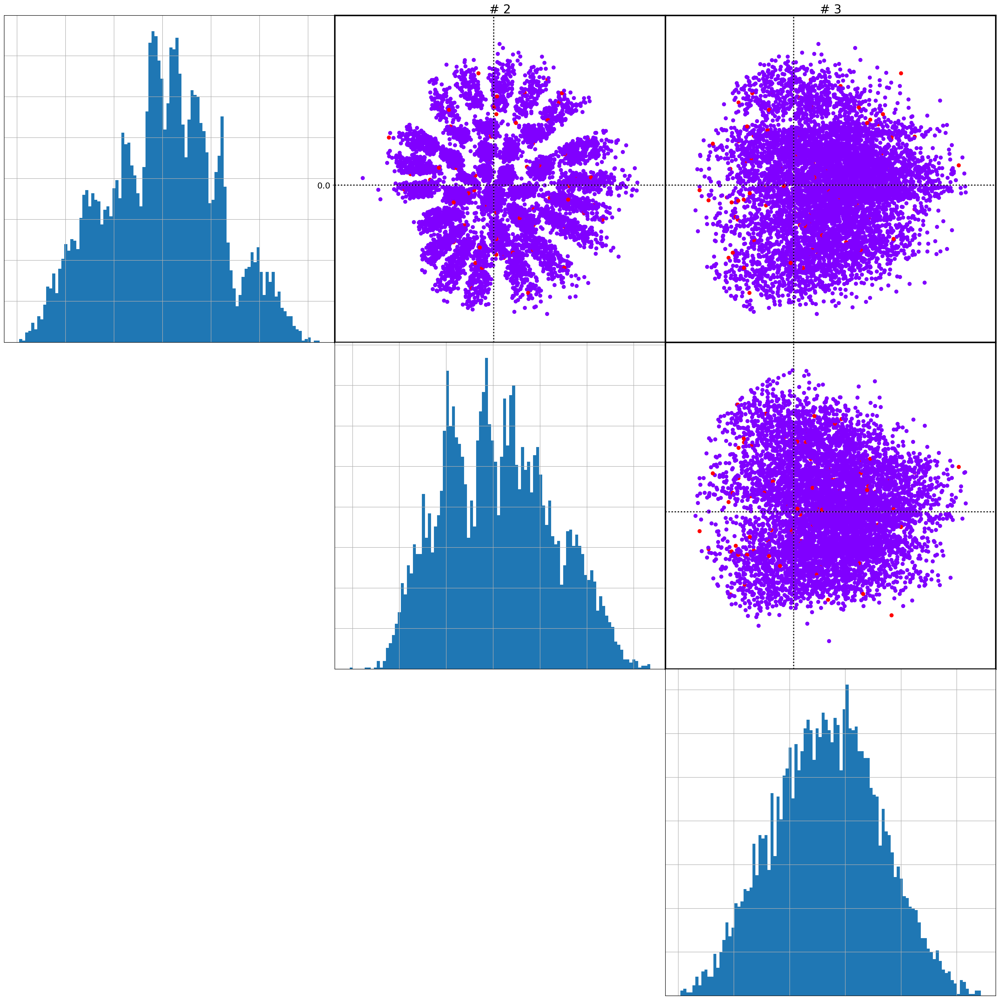

In [148]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=np.where(Zscore_kept[index]>1,1,0))

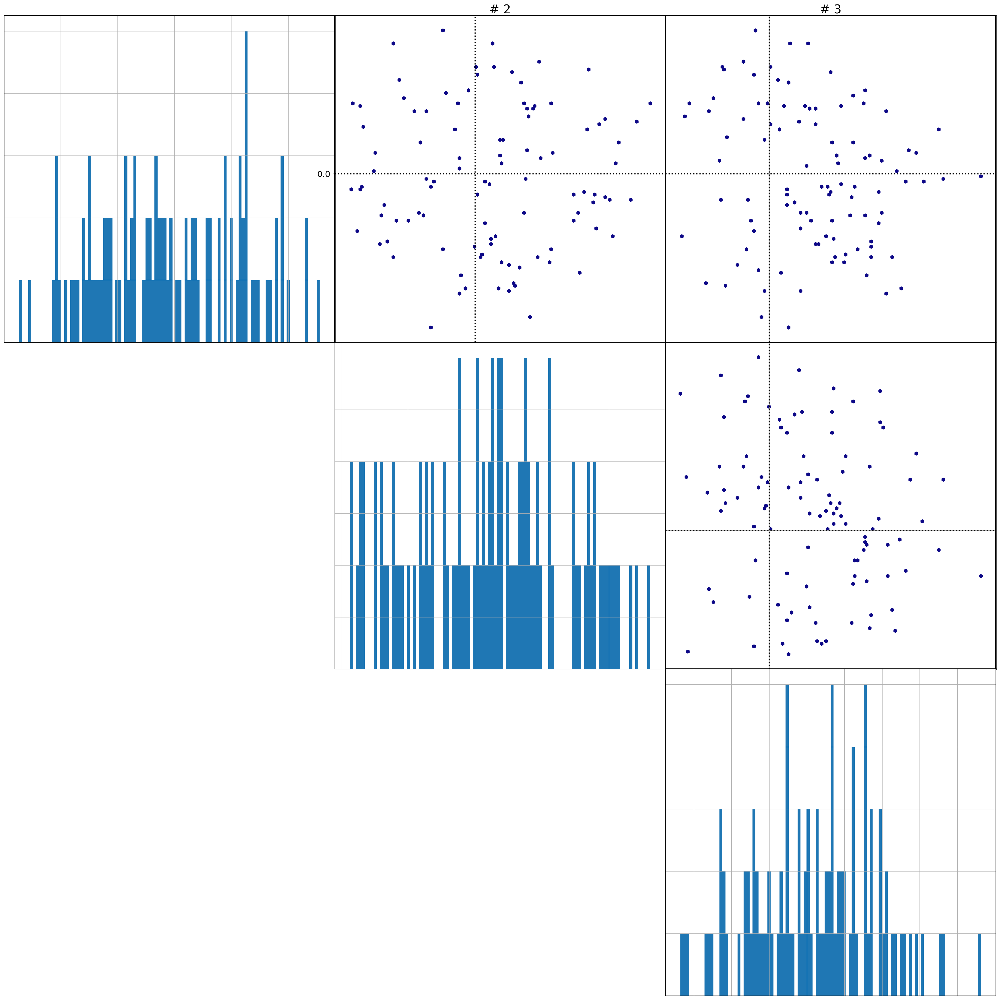

In [149]:
viz.biplots(U_restricted[np.where(Zscore_kept>1)], n=3, show_histo=True, nbins=100)#, c=np.where(Zscore_kept[index]>1,1,0))

In [23]:
angle_pred, defocus_pred = pred.pred2d(U_restricted,  angle_true[index], defocus_true[index], 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

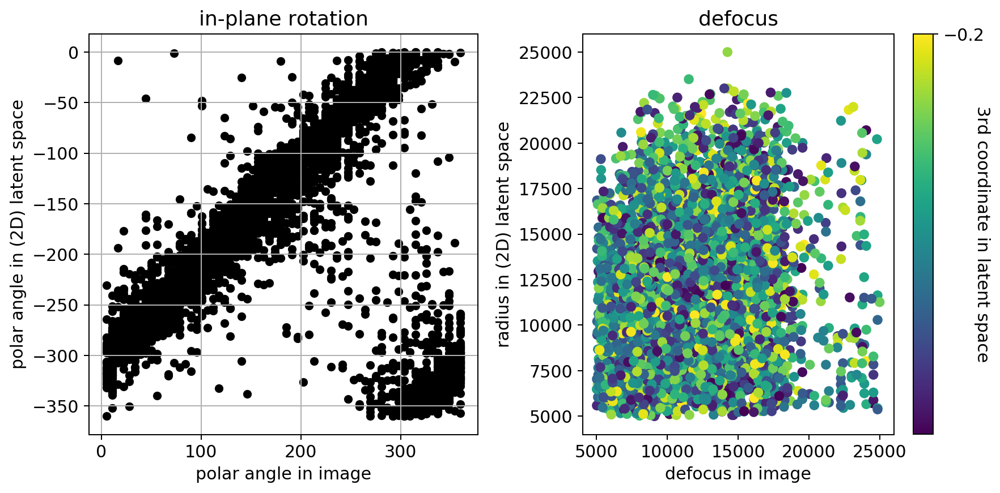

In [24]:
viz.plot_pred2d(angle_pred, defocus_pred, angle_true[index], defocus_true[index], metadata=angle_pred,
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

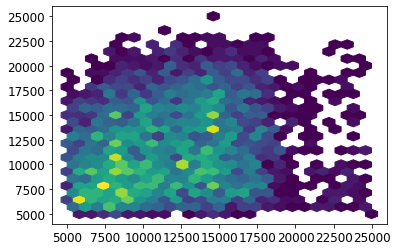

In [25]:
plt.hexbin(defocus_true[index],defocus_pred,gridsize=25,mincnt=1)

offset: -56 angle RMSE = 31.161269158609777
offset: -55 angle RMSE = 31.064221923403142
offset: -54 angle RMSE = 30.998546726439788
offset: -53 angle RMSE = 30.965043432068914
offset: -52 angle RMSE = 30.960907599635295
offset: -51 angle RMSE = 30.98712032461747
defocus RMSE = 5305.248929120135


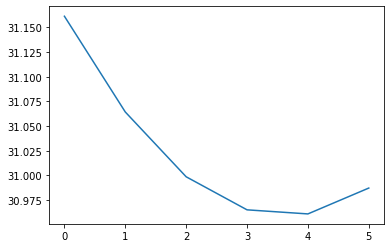

In [24]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(-56,-50,1))
plt.plot(angle_RMSE_list)

### weight angle RMSE with defocus pred

In [25]:
angle_pred, defocus_pred = pred.pred2d(U_restricted,  angle_true[index], defocus_true[index], 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

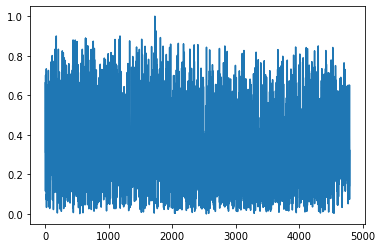

In [26]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)
plt.plot(defocus_pred_normalized)

offset: -54.0 angle RMSE = 30.998546726439788
offset: -53.75 angle RMSE = 30.987148996001665
offset: -53.5 angle RMSE = 30.977764712673846
offset: -53.25 angle RMSE = 30.97039572135558
offset: -53.0 angle RMSE = 30.965043432068914
offset: -52.75 angle RMSE = 30.96170890307369
offset: -52.5 angle RMSE = 30.959907698169367
offset: -52.25 angle RMSE = 30.959398276342025
offset: -52.0 angle RMSE = 30.960907599635295
offset: -51.75 angle RMSE = 30.96443533961819
offset: -51.5 angle RMSE = 30.96998083104254
offset: -51.25 angle RMSE = 30.977542985434123
offset: -51.0 angle RMSE = 30.98712032461747
offset: -50.75 angle RMSE = 30.998710988489997
offset: -50.5 angle RMSE = 31.012312726920243
offset: -50.25 angle RMSE = 31.027922866278256
defocus RMSE = 5305.248929120135


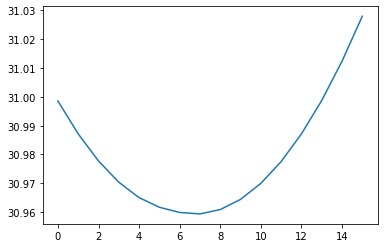

In [46]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(-54,-50,0.25),
                                                angle_weight=None, norm_weights=True)
plt.plot(angle_RMSE_list)

offset: -54.0 angle RMSE = 20.515548211560876
offset: -53.75 angle RMSE = 20.507711665354893
offset: -53.5 angle RMSE = 20.502920694805038
offset: -53.25 angle RMSE = 20.501177443644956
offset: -53.0 angle RMSE = 20.502482678595317
offset: -52.75 angle RMSE = 20.506835811682635
offset: -52.5 angle RMSE = 20.514145690422282
offset: -52.25 angle RMSE = 20.524299980508225
defocus RMSE = 5305.248929120135


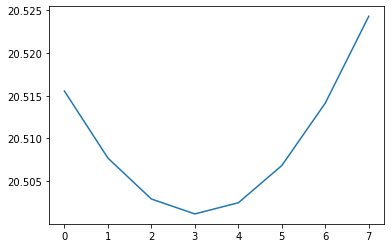

In [47]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(-54,-52,0.25),
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(angle_RMSE_list)

offset: -53.0 angle RMSE = 31.004977854930388
offset: -52.75 angle RMSE = 30.9998498012835
offset: -52.5 angle RMSE = 30.996325365127564
offset: -52.25 angle RMSE = 30.994094856192778
offset: -52.0 angle RMSE = 30.99388079266536
offset: -51.75 angle RMSE = 30.995683183536592
offset: -51.5 angle RMSE = 30.999501700210995
offset: -51.25 angle RMSE = 31.005335593906736
defocus RMSE = 5305.248929120135


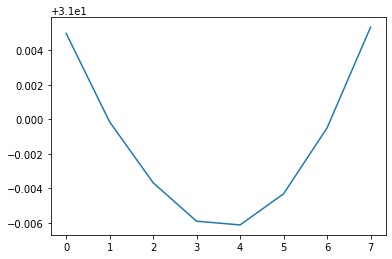

In [48]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(-53,-51,0.25),
                                                angle_weight=np.exp(-np.abs(Zscore[index])), norm_weights=True)
plt.plot(angle_RMSE_list)

### Remove central disk

In [27]:
U_norm = np.linalg.norm(U_restricted[:,0:2], axis=1)
index_shell = U_norm>np.max(U_norm)/20
print(len(index_shell))
U_shell = U_restricted[index_shell]

4798


In [28]:
U_norm.shape

(4798,)

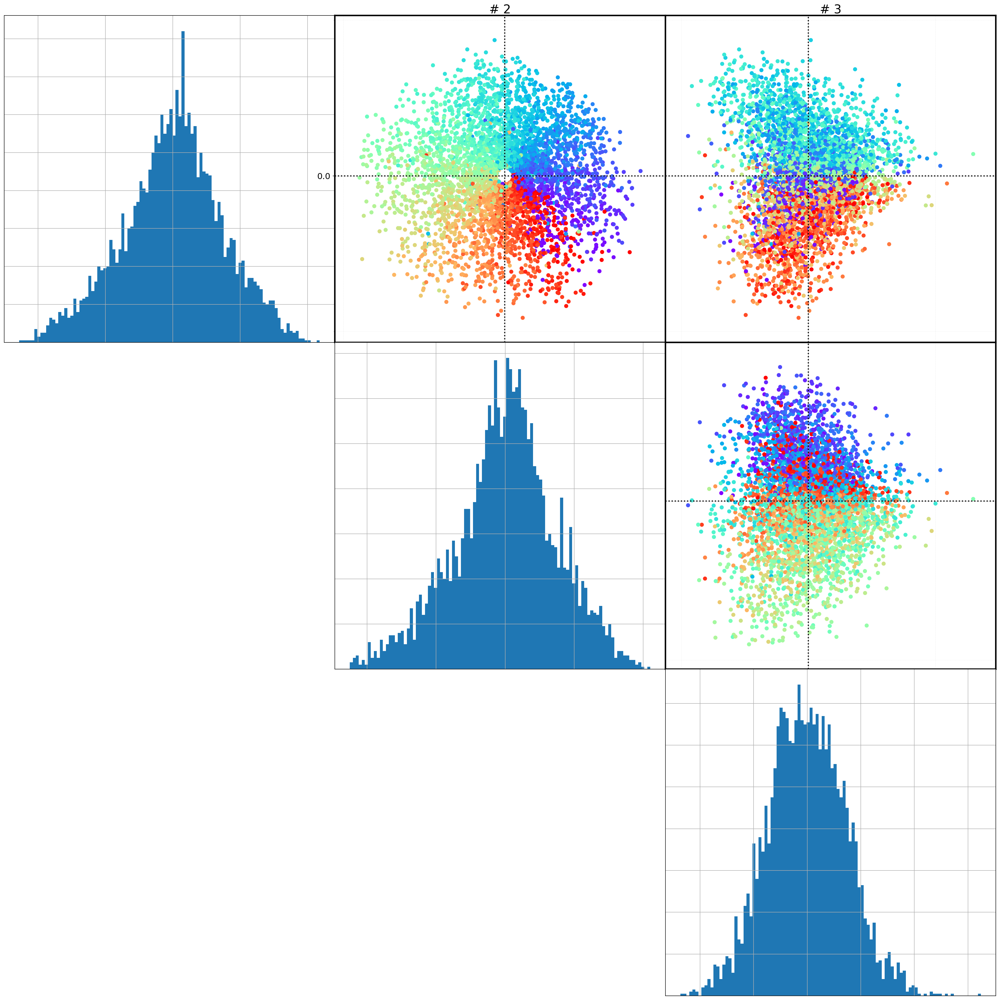

In [47]:
viz.biplots(U_shell, n=3, show_histo=True, nbins=100, c=angle_restricted[index_shell])

In [29]:
angle_pred, defocus_pred = pred.pred2d(U_shell,  angle_restricted[index_shell], defocus_restricted[index_shell], 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

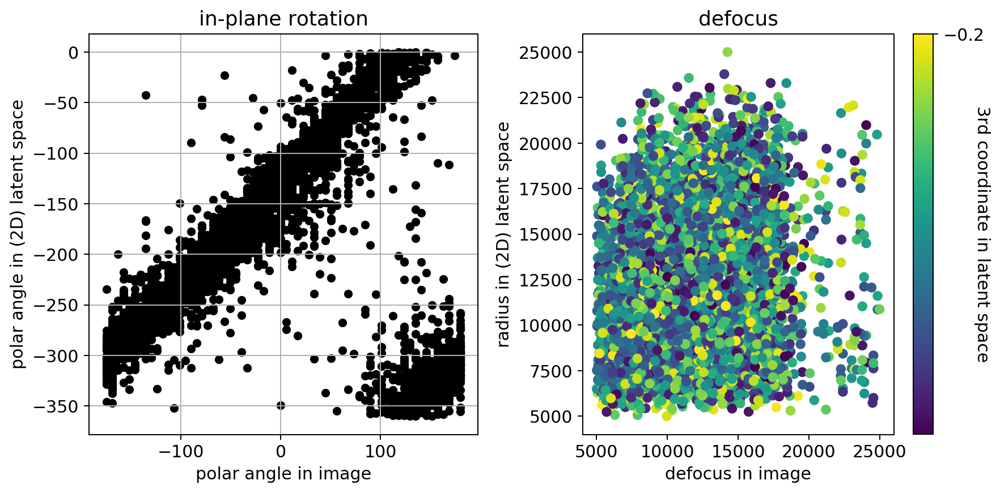

In [30]:
viz.plot_pred2d(angle_pred, defocus_pred, angle_restricted[index_shell], defocus_restricted[index_shell], metadata=angle_pred,
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

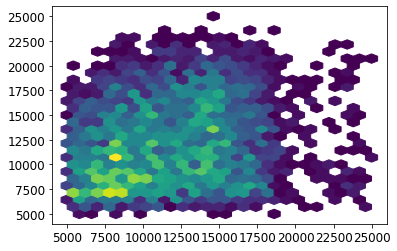

In [52]:
plt.hexbin(defocus_restricted[index_shell],defocus_pred,gridsize=25,mincnt=1)

offset: -240 angle RMSE = 28.478750750355285
offset: -238 angle RMSE = 28.024663586721417
offset: -236 angle RMSE = 27.699471078347457
offset: -234 angle RMSE = 27.513674109826297
offset: -232 angle RMSE = 27.4676738878472
offset: -230 angle RMSE = 27.566300883942226
offset: -228 angle RMSE = 27.808789683632657
offset: -226 angle RMSE = 28.19142817461563
offset: -224 angle RMSE = 28.708613020258174
offset: -222 angle RMSE = 29.353233235872278
defocus RMSE = 5280.114250164366


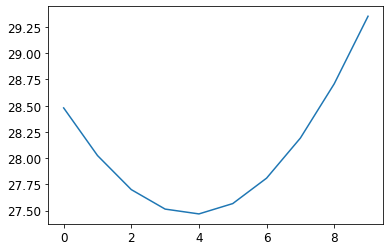

In [56]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_restricted[index_shell], defocus_restricted[index_shell], 
                                                angle_offset_range=np.arange(-240,-220,2))
plt.plot(angle_RMSE_list)